# Self Case Study 1:  Instacart Market Basket Analysis.

# **1) Business Problem**

**1.1   Problem Description**

Instacart is the company that half of American households use to get groceries from their favorite grocery stores like Costco, Wegman’s, Wallmart, Whole Foods, Petco, and more without even leaving the house.
Whether you shop from meticulously planned grocery lists or shop just for the heck of it, our unique food rituals define who we are. Instacart, a grocery ordering and delivery app, aims to make it easy to fill your refrigerator and pantry with your personal favorites and staples when you need them. After selecting products through the Instacart app, personal shoppers review your order and do the in-store shopping and delivery for you.
Instacart’s data science team plays a big part in providing this delightful shopping experience. Currently they use transactional data to develop models that predict which products a user will buy again, try for the first time, or add to their cart next during a session. Recently, Instacart open sourced this data - see their blog post on 3 Million Instacart Orders, Open Sourced.

Instacart currently uses XGBoost, word2vec and Annoy in production on similar data to sort items for users to “buy again”:

Context: Source: https://www.kaggle.com/competitions/instacart-market-basket-analysis/overview

**1.2 Problem Statement**

To use this data on customer orders over time to predict which previously purchased products will be in a user’s next order.


**1.3 Instacart’s Business Model**

**The users experience.**
1.	Download the Instacart App.
2.	Choose a store to shop from.
3.	From the store’s inventory, select which items you want to add to your cart.
4.	Select a one-hour time window during which you want your groceries to be delivered, which could be within the next hour.
<img src='https://tikolu.net/i/zljyl' />


**The delivery persons experience.**
1.	In the Instacart app, the shopper is on their shift, and are given a chance to acknowledge an order when it comes in the system.
2.	They drive to the store of that order and are presented with a list of the items you would like to purchase.
3.	As they find items, they pick them up, and scan the barcode to make sure it is the exact version of the product that you want.
4.	They would check out and drive to your address to deliver your groceries.
<img src='https://tikolu.net/i/vphrc' />

There’s two obvious sides to this marketplace — the shopper and the client.<br> However, Instacart is actually a four-sided marketplace.
<img src='https://tikolu.net/i/cseaq' />

Source: https://towardsdatascience.com/how-instacart-uses-data-science-to-tackle-complex-business-problems-774a826b6ed5


**1.4. Real-world/ Business objectives and constraints.** 
*	No low-latency requirement. 
*	Some Interpretability will help.
*	 Errors are not very costly. Probability that customer will buy the particular product is needed.


**1.5.  Dataset overview**

The dataset consists of over 3 million grocery orders from more than 200,000 Instacart users. For each user, we have around 4 to 100 of their orders, with the sequence of products purchased in each order.
This Dataset comes with 6 different CSV files such as:-<br><br>
**1. products.csv**
*	product_id: Provides id of the product. (Primary key)
*	product_name: Provides a name of every product.
Eg: Peach Mango Juice, Fresh Foaming Cleanser
*	department_id: It provides which department_id the particular product belongs to.
*	aisle_id: It provides which aisle_id the particular product belongs to. 
Aisle: Just like customers walk up and down the aisles when they go in-person, consumers usually take a ‘what sounds good’ approach for some of the items they buy. In these moments, consumers are looking for something to catch their eye without explicitly stating what they’re after.<br><br>

**2.	orders.csv**
*	order_id: Provides id of the order. (Primary key)
*	user_id: Provides id of the user. (Foreign  key)
*	eval_set: Provides info about which dataset this order belongs to.<br>
(i)	Prior: Users previous order history. ----> (build model)<br>
(ii)	Train: Data to be used to train the model.  ----> (use as validation set)<br>
(iii)	Test: Data to be used to test the model.  ----> (use to test model)<br>
*	order_number: Provides order number made by the user.
*	order_dow: Which day of the week user placed the order. Range [0-6]
*	order_hour_of_day: Which hour of day user placed the order. Range [0-23]
*	days_since_prior_order: How many days ago the user placed the order. Range 
[0-30]<br><br>

**3.	order_products__train.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**4.	order_products__prior.csv**
*	order_id: Provides id of the order. (Foreign  key)
*	product_id: Provides id of the product. (Foreign  key)
*	add_to_cart_order: Sequence number in which this product was added to the cart of the corresponding order (Good for association rule mining i.e To create bundles of products that are favorable to be bought together)
•	reordered: 1=> reordered,  0=> did not reorder<br><br>

**5.	 aisles.csv**
*	aisle_id: Provides id to every aisle name. (Primary key)
*	aisle: Name of the aisle. Eg. frozen meat seafood, baby bath body care<br><br>

**6.	 departments.csv**
*	department_id: Provides id to every department name. (Primary key)
*	department: Name of the department. Eg. Frozen, babies<br><br>
<img src='https://tikolu.net/i/xobeg' />

Image: https://blog.ineuron.ai/Instacart-Customer-Basket-Analysis-Case-Study-oYecAA8f


*  Quantity and price of a product bought in a single order is not given.

**1.4. Notebook split up into 4 major tasks** 
## 1. 	**Cluster user into groups based on Buying habits/ Loyalty**
2.	Predicts if user will reorder product or not.<br>
u1 -->  x,y    (assume user1 is likely to reorder products x and y, then these 2 will be recommended.)
3.	Show similar products to x and y to user u1 
4.	Suggest products to buy along with products x and y. (Making bundles for user)

#Import Everything + helper functions

In [48]:
###########################  Basic  #############################
# from IPython.display import set_matplotlib_formats
# set_matplotlib_formats('pdf', 'svg', facecolor='w')

import pylab 
import scipy.stats as stats
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)
import gdown
import os, zipfile
import shutil
import pandas as pd
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from google.colab import drive
# %matplotlib inline


###########################  clustering  #############################


import statsmodels.api as sm
sns.set()
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
from yellowbrick.cluster import KElbowVisualizer
from sklearn.model_selection import train_test_split
from sklearn import preprocessing




def connect_to_drive():
  """Connects to Drive
  """
  drive.mount('/content/drive')



def remove_dir(abs_path):
  """Removes entire folder and all folders/files present in it.
  """
  try:
    shutil.rmtree(abs_path)
  except:
    print("No such folder present")
  else:
    print("Deleted successfully")



def nans_by_row(df): 
  """ 
  Filters dataframe and returns only those rows that have atleast 1 NaN value
  """
  return df[df.isnull().any(axis=1)]


def histplot(data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False):
    """ 
    Plots histogram for inputed data.  
    params --> (data, bins,title,xlabel,ylabel,xticks_step_size,x_labelsize=10,w=10,h=4, stat='probability',cumulative = False)
    """
    
    plt.rcParams["figure.figsize"] = (w,h)
    plt.rcParams["xtick.labelsize"] = x_labelsize

    ax = sns.histplotlot(x=data,stat=stat, kde=True,bins = bins, cumulative = cumulative)
    ax.set(xlabel='days since prior order', ylabel='density',title='PDF of re-order frequency')
    ax.set_xticks(range(0,int(max(data)) + xticks_step_size, xticks_step_size))
    plt.show()


def save_csv(df , file_name):
  df.to_csv(file_name)



# **2) EDA**

### **Getting dataset**

In [2]:
import gdown
import os, zipfile
#https://github.com/wkentaro/gdown

#downloading dataset
id = "1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU"
!mkdir /content/dataset
output = "/content/dataset/instacart-market-basket-analysis.zip"
gdown.download(id=id, output=output, quiet=False)


Downloading...
From: https://drive.google.com/uc?id=1COIqQfAqrDSypQj9XK8Jl3axF6CUB8xU
To: /content/dataset/instacart-market-basket-analysis.zip
100%|██████████| 206M/206M [00:02<00:00, 78.4MB/s]


'/content/dataset/instacart-market-basket-analysis.zip'

In [3]:
# unzipping dataset
!unzip /content/dataset/instacart-market-basket-analysis.zip -d /content/dataset
os.remove("/content/dataset/instacart-market-basket-analysis.zip") # delete zipped file

Archive:  /content/dataset/instacart-market-basket-analysis.zip
  inflating: /content/dataset/aisles.csv.zip  
  inflating: /content/dataset/departments.csv.zip  
  inflating: /content/dataset/order_products__prior.csv.zip  
  inflating: /content/dataset/order_products__train.csv.zip  
  inflating: /content/dataset/orders.csv.zip  
  inflating: /content/dataset/products.csv.zip  
  inflating: /content/dataset/sample_submission.csv.zip  


In [4]:
# unzipping internal files
# https://stackoverflow.com/questions/31346790/unzip-all-zipped-files-in-a-folder-to-that-same-folder-using-python-2-7-5


dir_name = '/content/dataset'
extension = ".zip"

os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension) and item!="instacart-market-basket-analysis.zip": # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [5]:
# delete dir
remove_dir("/content/dataset/__MACOSX")

Deleted successfully


### **Load/View datasets**

In [6]:
import pandas as pd
import numpy as np

aisle_df = pd.read_csv("/content/dataset/aisles.csv")
dept_df = pd.read_csv("/content/dataset/departments.csv")
order_prod_pr_df = pd.read_csv("/content/dataset/order_products__prior.csv")
order_prod_tr_df = pd.read_csv("/content/dataset/order_products__train.csv")
orders_df = pd.read_csv("/content/dataset/orders.csv")
products_df = pd.read_csv("/content/dataset/products.csv")


In [7]:
aisle_df.info()
aisle_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134 entries, 0 to 133
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   aisle_id  134 non-null    int64 
 1   aisle     134 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.2+ KB


,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation
...,...,...
129,130,hot cereal pancake mixes
130,131,dry pasta
131,132,beauty
132,133,muscles joints pain relief


In [8]:
dept_df.info()
dept_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21 entries, 0 to 20
Data columns (total 2 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   department_id  21 non-null     int64 
 1   department     21 non-null     object
dtypes: int64(1), object(1)
memory usage: 464.0+ bytes


,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol
5,6,international
6,7,beverages
7,8,pets
8,9,dry goods pasta
9,10,bulk


In [9]:
order_prod_pr_df.info()
order_prod_pr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32434489 entries, 0 to 32434488
Data columns (total 4 columns):
 #   Column             Dtype
---  ------             -----
 0   order_id           int64
 1   product_id         int64
 2   add_to_cart_order  int64
 3   reordered          int64
dtypes: int64(4)
memory usage: 989.8 MB


,order_id,product_id,add_to_cart_order,reordered
0,2,33120,1,1
1,2,28985,2,1
2,2,9327,3,0
3,2,45918,4,1
4,2,30035,5,0
...,...,...,...,...
32434484,3421083,39678,6,1
32434485,3421083,11352,7,0
32434486,3421083,4600,8,0
32434487,3421083,24852,9,1


In [10]:
order_prod_tr_df.info()
order_prod_tr_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1384617 entries, 0 to 1384616
Data columns (total 4 columns):
 #   Column             Non-Null Count    Dtype
---  ------             --------------    -----
 0   order_id           1384617 non-null  int64
 1   product_id         1384617 non-null  int64
 2   add_to_cart_order  1384617 non-null  int64
 3   reordered          1384617 non-null  int64
dtypes: int64(4)
memory usage: 42.3 MB


,order_id,product_id,add_to_cart_order,reordered
0,1,49302,1,1
1,1,11109,2,1
2,1,10246,3,0
3,1,49683,4,0
4,1,43633,5,1
...,...,...,...,...
1384612,3421063,14233,3,1
1384613,3421063,35548,4,1
1384614,3421070,35951,1,1
1384615,3421070,16953,2,1


In [11]:
orders_df.info()
orders_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3421083 entries, 0 to 3421082
Data columns (total 7 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   order_id                int64  
 1   user_id                 int64  
 2   eval_set                object 
 3   order_number            int64  
 4   order_dow               int64  
 5   order_hour_of_day       int64  
 6   days_since_prior_order  float64
dtypes: float64(1), int64(5), object(1)
memory usage: 182.7+ MB


,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
1,2398795,1,prior,2,3,7,15.0
2,473747,1,prior,3,3,12,21.0
3,2254736,1,prior,4,4,7,29.0
4,431534,1,prior,5,4,15,28.0
...,...,...,...,...,...,...,...
3421078,2266710,206209,prior,10,5,18,29.0
3421079,1854736,206209,prior,11,4,10,30.0
3421080,626363,206209,prior,12,1,12,18.0
3421081,2977660,206209,prior,13,1,12,7.0


In [12]:
# Displays all rows with atleast 1 row with null value.
nans_by_row(orders_df)

,order_id,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order
0,2539329,1,prior,1,2,8,NaN
11,2168274,2,prior,1,2,11,NaN
26,1374495,3,prior,1,1,14,NaN
39,3343014,4,prior,1,6,11,NaN
45,2717275,5,prior,1,3,12,NaN
...,...,...,...,...,...,...,...
3420930,969311,206205,prior,1,4,12,NaN
3420934,3189322,206206,prior,1,3,18,NaN
3421002,2166133,206207,prior,1,6,19,NaN
3421019,2227043,206208,prior,1,1,15,NaN


**observations/conclusions**

* Every users 1st order ever placed has days_since_prior_order as NaN, as there are no previous orders that they have placed.

In [13]:
products_df.info()
products_df

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49688 entries, 0 to 49687
Data columns (total 4 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   product_id     49688 non-null  int64 
 1   product_name   49688 non-null  object
 2   aisle_id       49688 non-null  int64 
 3   department_id  49688 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB


,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13
...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5
49684,49685,En Croute Roast Hazelnut Cranberry,42,1
49685,49686,Artisan Baguette,112,3
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8


In [14]:
print("Total Users that placed orders:",len(orders_df['user_id'].unique()))
print("Total Products ever purchased:", len(products_df['product_id'].unique()))

Total Users that placed orders: 206209
Total Products ever purchased: 49688


## **Task 1: Cluster users based on Buying habits**
## **Loyality of user features**



1.  num_of_orders                          
2.  mean_order_size                        
3.  median_order_size                      
4.  avg_reorder_freq                       
5.  avg_order_size_to_re_order_freq_ratio  
6.  aisles_shopped_in_count                
7.  avg_prods_purchased_per_aisle 


### Performance metric for clusting:
1. Sum of squared errors (SSE) / Inertia / WCSS (WIthin cluster sum of square) / Distortion score

<img src = "https://tikolu.net/i/wrpzc">



using elbow method

###**1) Distribution of "Number of orders per customer"**

In [ ]:
#using only prior data to perform eda
orders_prior = orders_df[orders_df['eval_set'] == 'prior']
orders_per_user_grp = orders_prior.groupby(by="user_id",axis=0)
orders_per_user = sorted(orders_per_user_grp.count()['order_id'].values)
print("Maximum number of orders by a customer is ",max(orders_per_user))
print("Minimum number of orders by a customer is ",min(orders_per_user))

Maximum number of orders by a customer is  99
Minimum number of orders by a customer is  3


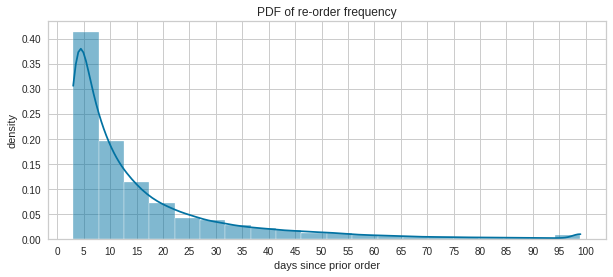

In [ ]:

tot_users = len(orders_df['user_id'].unique())
user_per_bin = 0.05*tot_users
bins  = int(tot_users/user_per_bin)


histplot(data= orders_per_user, bins = bins ,
    title="PDF of number of orders placed by customers",
    xlabel="number of orders", 
    ylabel = "prob density",
    xticks_step_size=5,
    w = 10, h = 4,
    stat= "probability")

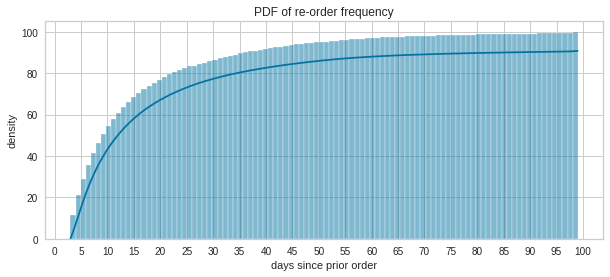

In [ ]:
tot_users = len(orders_df['user_id'].unique())

histplot(data= orders_per_user, bins = 100 ,
    title="CDF of number of orders placed by customers",
    xlabel="number of orders", 
    ylabel = "percentage of customers",
    xticks_step_size=5,
    w = 10, h = 4,
    stat= "percent",
    cumulative = True)

In [ ]:
percentile = 96
tot_users = len(orders_df['user_id'].unique())
print(f"Only {100-percentile}% of customers placed more than",int(np.percentile(orders_per_user, percentile)),"orders")

Only 4% of customers placed more than 55 orders


**Observations**


*   Only 4 % of all the 2,06,209 customers (i.e 8296 customers) have more than 55 orders.
*   Maximum number of orders by a single person is 100.
*  Ever user has placed atleast 3 orders. 





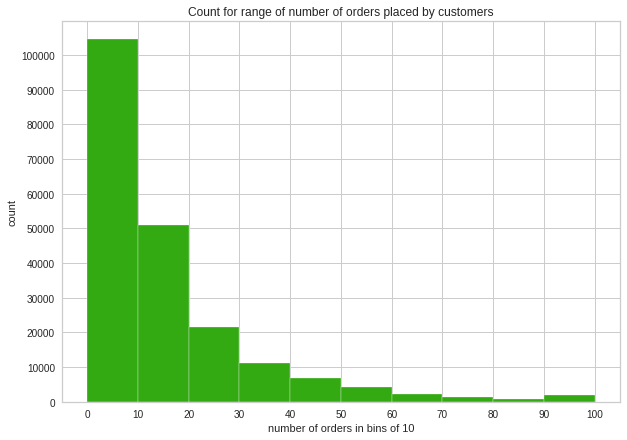

In [ ]:

#Binning
bins =  range(0,110,10)
 
# Creating histogram
fig, ax = plt.subplots(figsize =(10, 7))
counts, bins, bars = ax.hist(orders_per_user, bins = bins,color="#33AA11")

plt.title("Count for range of number of orders placed by customers")

plt.xlabel("number of orders in bins of 10")
plt.ylabel("count")

plt.yticks(range(0,round(ax.get_ybound()[1]), 10000))
plt.xticks(range(0,110,10))

# Show plot
plt.show()

In [ ]:

order_distribution = (counts/tot_users)*100
bin_size = bins[1]-bins[0]
for i, bin in enumerate(bins[0:10]):
  print(round(order_distribution[i],1),f"% of customers have between {bin} and {bin+bin_size} orders")

50.7 % of customers have between 0 and 10 orders
24.7 % of customers have between 10 and 20 orders
10.4 % of customers have between 20 and 30 orders
5.5 % of customers have between 30 and 40 orders
3.4 % of customers have between 40 and 50 orders
2.1 % of customers have between 50 and 60 orders
1.1 % of customers have between 60 and 70 orders
0.7 % of customers have between 70 and 80 orders
0.4 % of customers have between 80 and 90 orders
0.9 % of customers have between 90 and 100 orders


**Observations**


*   Exactly half of our customers have made between 4 to 10 orders.
*   There are more customers that have between 90 to 100 orders, than customers who have order between 70 to 80 and 80 to 90 orders. This shows that instacart has a few 1% that are extremely loyal who order very frequently.
*   ***Number of orders placed per person*** is useful in determining whether a customer is a loyal customer or not.

###**Compare customers that placed 4-10 orders (50% of customers) and the small 1% of Loyal/Regular customers who placed between 90 to 100 orders**

In [ ]:
# Getting only prev orders
orders_prior = orders_df[orders_df['eval_set'] == 'prior']

# Merging all tables into one big table (Memory heavy)
merg_df = pd.merge(
              pd.merge(
                   pd.merge(
                       pd.merge(
                           order_prod_pr_df, 
                           orders_prior,on='order_id',
                           how='left')
                   ,products_df, on='product_id',how='left')
               ,aisle_df, on='aisle_id',how='left')
          ,dept_df, on='department_id',how='left')

In [ ]:
merg_df.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
0,2,33120,1,1,202279,prior,3,5,9,8.0,Organic Egg Whites,86,16,eggs,dairy eggs
1,2,28985,2,1,202279,prior,3,5,9,8.0,Michigan Organic Kale,83,4,fresh vegetables,produce
2,2,9327,3,0,202279,prior,3,5,9,8.0,Garlic Powder,104,13,spices seasonings,pantry
3,2,45918,4,1,202279,prior,3,5,9,8.0,Coconut Butter,19,13,oils vinegars,pantry
4,2,30035,5,0,202279,prior,3,5,9,8.0,Natural Sweetener,17,13,baking ingredients,pantry


In [ ]:
# Sorting df
merg_df.sort_values(["user_id","order_id","product_id"], ascending=[True,True,False],inplace=True)

In [ ]:
#Grouping rows by order id
orders_per_user_grp = merg_df.groupby(by=["order_id"],axis=0)

In [ ]:
#  .first() Heavy operation
orders_per_user_df = orders_per_user_grp.first()
orders_per_user_df.head()

,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
order_id,,,,,,,,,,,,,,
2,45918,4,1,202279,prior,3,5,9,8.0,Coconut Butter,19,13,oils vinegars,pantry
3,46667,6,1,205970,prior,16,5,17,12.0,Organic Ginger Root,83,4,fresh vegetables,produce
4,46842,1,0,178520,prior,36,1,9,7.0,Plain Pre-Sliced Bagels,93,3,breakfast bakery,bakery
5,48825,25,0,156122,prior,42,6,16,9.0,Bag of Organic Lemons,24,4,fresh fruits,produce
6,41897,3,0,22352,prior,4,1,12,30.0,Clean Day Lavender Scent Room Freshener Spray,101,17,air fresheners candles,household


In [ ]:
orders_per_user_grp = orders_per_user_df.groupby(by="user_id")
orders_per_user_df = orders_per_user_grp.count()
orders_per_user_df['user_id'] = orders_per_user_df.index
orders_per_user_df = orders_per_user_df[['user_id','add_to_cart_order']]

In [ ]:
orders_per_user_df['user_id'] = orders_per_user_df.index
orders_per_user_df.reset_index(drop = True, inplace = True)
orders_per_user_df.rename(columns={'add_to_cart_order':'num_of_orders'}, inplace=True)
orders_per_user_df[['user_id','num_of_orders']].head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:5047: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,user_id,num_of_orders
0,1,10
1,2,14
2,3,12
3,4,5
4,5,4


In [ ]:
user_loyalty_df = orders_per_user_df.copy()
# Merging new feature with big merged table
merg_df = pd.merge(merg_df, orders_per_user_df, on='user_id', how='left')
merg_df.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department,num_of_orders
0,431534,41787,7,0,1,prior,5,4,15,28.0,Bartlett Pears,24,4,fresh fruits,produce,10
1,431534,25133,4,1,1,prior,5,4,15,28.0,Organic String Cheese,21,16,packaged cheese,dairy eggs,10
2,431534,17122,6,0,1,prior,5,4,15,28.0,Honeycrisp Apples,24,4,fresh fruits,produce,10
3,431534,13176,8,1,1,prior,5,4,15,28.0,Bag of Organic Bananas,24,4,fresh fruits,produce,10
4,431534,12427,2,1,1,prior,5,4,15,28.0,Original Beef Jerky,23,19,popcorn jerky,snacks,10


Aisles they shop in generally

In [ ]:
ailes_0_10 = merg_df[ (merg_df['num_of_orders']>=0) & (merg_df['num_of_orders']<=10)]['aisle'].values

# Getting unique ailses and and number of times users shopped in them
unique, counts = np.unique(ailes_0_10, return_counts=True)
d = dict(zip(unique, counts))


# Getting % and count of num of times shooped in the ailse group of users
s = sum(d.values())
for k, v in d.items():
    d[k] = (round(v * 100.0 / s,2),v)

#Sorting percentage and getting top x values
sorted(d.items(), key=lambda x: x[1], reverse = True)[:10]

[('fresh vegetables', (10.54, 658690)),
 ('fresh fruits', (9.93, 620735)),
 ('packaged vegetables fruits', (5.25, 328080)),
 ('yogurt', (4.03, 251898)),
 ('packaged cheese', (3.04, 189927)),
 ('water seltzer sparkling water', (2.5, 156236)),
 ('chips pretzels', (2.29, 142802)),
 ('milk', (2.27, 142113)),
 ('soy lactosefree', (1.83, 114269)),
 ('bread', (1.76, 109708))]

In [ ]:
ailes_90_100 = merg_df[ (merg_df['num_of_orders']>=90) & (merg_df['num_of_orders']<=100)]['aisle'].values

# Getting unique ailses and and number of times users shopped in them
unique, counts = np.unique(ailes_90_100, return_counts=True)
d = dict(zip(unique, counts))

# Getting % and count of num of times shooped in the ailse group of users
s = sum(d.values())
for k, v in d.items():
    d[k] = (round(v * 100.0 / s,2),v)

#Sorting percentage and getting top x values
sorted(d.items(), key=lambda x: x[1], reverse = True)[:10]

[('fresh fruits', (13.22, 215245)),
 ('fresh vegetables', (11.01, 179249)),
 ('packaged vegetables fruits', (5.74, 93521)),
 ('yogurt', (5.04, 82046)),
 ('milk', (3.55, 57882)),
 ('packaged cheese', (2.76, 44973)),
 ('water seltzer sparkling water', (2.73, 44487)),
 ('soy lactosefree', (2.4, 39092)),
 ('refrigerated', (1.94, 31547)),
 ('chips pretzels', (1.93, 31397))]

In [ ]:

orders_0_10 = merg_df[ (merg_df['num_of_orders']>=0) & (merg_df['num_of_orders']<=10)]['order_id'].values
orders_90_100 = merg_df[ (merg_df['num_of_orders']>=90) & (merg_df['num_of_orders']<=100)]['order_id'].values

tot_users = len(orders_df['user_id'].unique())
print((( 658690 + 620735 + 328080)/(0.507*tot_users*len(set(orders_0_10))))*100)

print(((215245 + 179249 + 93521)/(0.009*tot_users*len(set(orders_90_100))))*100)

print(0.14150275043691313/0.0024471828767855023)

0.0024133953419975367
0.14150275043691313
57.82271189425128


**Observations/Conclusions**


*   A single Regular/Loyal customer on AVERAGE has a 0.14% chance of ordering an item from the fruits and vegetable section in a single order.
*   A single newer customer on AVERAGE has a 0.002% chance of ordering an item from the fruits and vegetable section in a single order.
*   This means a Loyal customer is approximately 60 times more likely to buy a fruits or vegetable product in an order compared to a newer customer.


###**2) "Average size of orders (in products) per customer"**

In [ ]:
# https://towardsdatascience.com/customer-segmentation-using-the-instacart-dataset-17e24be9c0fe

temp = merg_df.groupby(["user_id","order_id"]).size().reset_index(name='count_of_prods_for_order')
temp.head()

,user_id,order_id,count_of_prods_for_order
0,1,431534,8
1,1,473747,5
2,1,550135,5
3,1,2254736,5
4,1,2295261,6


In [ ]:
print("Max unique products ordered by a user:",min(temp['count_of_prods_for_order']))
print("Min unique products ordered by a user:",max(temp['count_of_prods_for_order']))

Max unique products ordered by a user: 1
Min unique products ordered by a user: 145


**What did the user that ordered 145 unique products in a single order buy?**

In [ ]:
temp[temp['count_of_prods_for_order'] == 145]

,user_id,order_id,count_of_prods_for_order
357738,22906,1564244,145


In [ ]:
order_id = temp[temp['count_of_prods_for_order'] == 145]['order_id'].values[0]

t = merg_df[merg_df['order_id'] == order_id]['department'].values

unique, counts = np.unique(t, return_counts=True)
d = dict(zip(unique, counts))

s = sum(d.values())
for k, v in d.items():
    d[k] = (round(v * 100.0 / s,2),v)

sorted(d.items(), key=lambda x: x[1], reverse = True)[:10]

[('produce', (25.52, 37)),
 ('dairy eggs', (15.86, 23)),
 ('snacks', (15.17, 22)),
 ('beverages', (13.79, 20)),
 ('frozen', (13.1, 19)),
 ('deli', (5.52, 8)),
 ('bakery', (4.14, 6)),
 ('breakfast', (2.07, 3)),
 ('pantry', (2.07, 3)),
 ('household', (1.38, 2))]

**Observation/conclusion**

*   The customer that bought a whooping 145 unique items in a single order primarily bought **dairy egg products, fruits and vegetables, snacks, beverages and frozen foods**.






In [ ]:
avg_prod_per_order = temp.groupby(["user_id"]).agg({'count_of_prods_for_order': ['mean','median']})['count_of_prods_for_order'].reset_index(drop=False)
avg_prod_per_order.rename(columns={'mean':'mean_order_szie', 'median':'median_order_size'}, inplace=True)
avg_prod_per_order

,user_id,mean_order_szie,median_order_size
0,1,5.900000,5.5
1,2,13.928571,13.5
2,3,7.333333,7.0
3,4,3.600000,3.0
4,5,9.250000,10.0
...,...,...,...
206204,206205,10.666667,8.0
206205,206206,4.253731,4.0
206206,206207,13.937500,13.0
206207,206208,13.816327,13.0


In [ ]:
user_loyalty_df = pd.merge(user_loyalty_df, avg_prod_per_order, on='user_id', how='left')
user_loyalty_df.head()

,user_id,num_of_orders,mean_order_szie,median_order_size
0,1,10,5.900000,5.5
1,2,14,13.928571,13.5
2,3,12,7.333333,7.0
3,4,5,3.600000,3.0
4,5,4,9.250000,10.0


In [ ]:
user_loyalty_df.shape

(206209, 4)

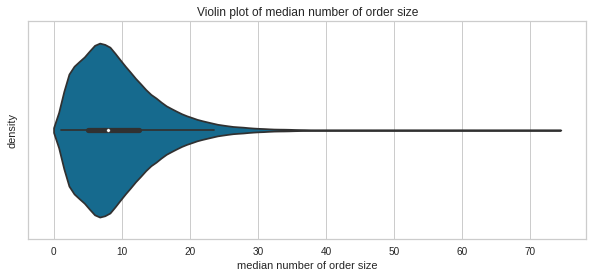

In [ ]:
ax =sns.violinplot(x=avg_prod_per_order["median_order_size"])
ax.set(xlabel='median number of order size', ylabel='density',title='Violin plot of median number of order size')
plt.show()

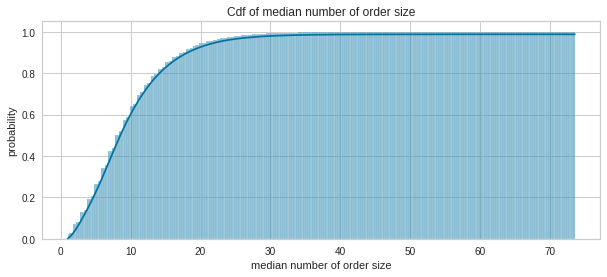

In [ ]:
ax =sns.histplot(avg_prod_per_order['median_order_size'],stat='probability',cumulative = True, kde=True)
ax.set(xlabel='median number of order size', ylabel='probability',title='Cdf of median number of order size')
plt.show()


In [ ]:
#getting users between the 90th and 100th percentile
avg_prod_per_order__99_per = avg_prod_per_order[(avg_prod_per_order['median_order_size'] > avg_prod_per_order['median_order_size'].quantile(0.90)) & (avg_prod_per_order['median_order_size'] <= avg_prod_per_order['median_order_size'].quantile(1))]
avg_prod_per_order__99_per = avg_prod_per_order__99_per.sort_values(["median_order_size"], ascending=[False])


print("Number of users that places an average order size of more than 20 items/order are",
      len(avg_prod_per_order__99_per[avg_prod_per_order__99_per['median_order_size']>20]))

Number of users that places an average order size of more than 20 items/order are 11641


In [ ]:
np.round((11641 /tot_users)*100)

6.0

**Observation/conclusion**

*   Only 6% of customers order more than 29 items per order on average.
*   This 6% shop in bulk whenever they shop with instacart. We can call these type of customers loyal.
*   ***Average order size per customer*** is useful in determining whether a customer is a loyal customer or not.

In [ ]:
merg_df = pd.merge(merg_df, avg_prod_per_order, on='user_id', how='left')
merg_df.head()

###**3) "Average lag between orders per customer" (in days)**

In [ ]:
avg_lag_between_orders_df = merg_df.groupby(["user_id"]).agg({'days_since_prior_order': ['mean']})['days_since_prior_order'].reset_index(drop=False)
avg_lag_between_orders_df

In [ ]:
avg_lag_between_orders_df.rename(columns={'mean':'avg_reorder_freq'}, inplace=True)
avg_lag_between_orders_df.head()

In [ ]:
user_loyalty_df = pd.merge(user_loyalty_df, avg_lag_between_orders_df, on='user_id', how='left')
user_loyalty_df.head()

In [ ]:

histplot(data= avg_lag_between_orders_df["avg_reorder_freq"], bins = 30 ,
    title="PDF of re-order frequency",
    xlabel="days since prior order", 
    ylabel = "density",
    xticks_step_size=5,
    w = 10, h = 4,
    stat= "probability")


**Observation/conclusion**

*   On average Customers seem to re-order the most,  weekly, fortnightly and monthy 
*   Customers that reorder more frequently (i.e between 1-6 days) can be termed as more loyal customers compared to others.
*  These small group of customers must be shopping only with instacart for all their needs, that is why they order so regularly.
*  But we should also check how many items they buy per order, this can further tell if a customer is loyal or not.
*   **As what if they order frequently but buy only 1 to 2 items per order, whereas a person that reorders monthly has a huge avg order size? Lets find out**

###**4,5) mean_order_szie, avg_order_size_to_re_order_freq_ratio**

**Checking avg order size of customers that order very frequently(1-4 days) vs Customers that order less frequently(24-30 days)**

In [ ]:
#Getting customers that reorder frequently
freq_re_orderers = avg_lag_between_orders_df[(avg_lag_between_orders_df['avg_reorder_freq']>=0) & (avg_lag_between_orders_df['avg_reorder_freq']<=4)]
freq_re_orderers

,user_id,avg_reorder_freq
89,90,3.535769
131,132,3.254545
140,141,3.535714
209,210,3.378489
258,259,3.272727
...,...,...
205803,205804,3.841789
205877,205878,3.029872
205971,205972,2.747537
206025,206026,2.720000


In [ ]:
print(f"Only {round((len(freq_re_orderers)/tot_users)*100,2)}% of all our customers order after 1 to 4 days on average")

Only 2.33% of all our customers order after 1 to 4 days on average


In [ ]:
#Getting their avg order sizes
t = pd.merge(freq_re_orderers, avg_prod_per_order,on='user_id', how='left')
t

,user_id,avg_reorder_freq,mean_order_szie,median_order_size
0,90,3.535769,9.436620,9.0
1,132,3.254545,4.833333,5.0
2,141,3.535714,10.250000,10.0
3,210,3.378489,14.909091,14.0
4,259,3.272727,5.333333,5.0
...,...,...,...,...
4790,205804,3.841789,17.883721,14.5
4791,205878,3.029872,7.171717,7.0
4792,205972,2.747537,8.313131,8.0
4793,206026,2.720000,1.928571,2.0


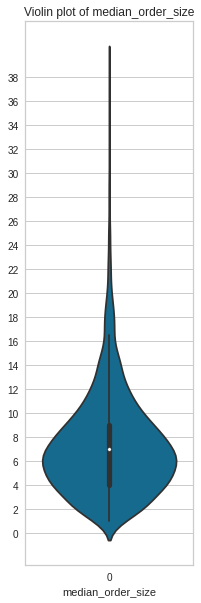

In [ ]:
plt.rcParams["figure.figsize"] = (3, 10)
plt.rcParams["xtick.labelsize"] = 10
ax = sns.violinplot(data = t["median_order_size"])
ax.set(xlabel='median_order_size',title='Violin plot of median_order_size')
ax.set_yticks(range(0,int(max(t["median_order_size"].values)),2))
plt.show()

In [ ]:
#Getting customers that reorder frequently
#Getting customers that reorder frequently
less_freq_re_orderers = avg_lag_between_orders_df[(avg_lag_between_orders_df['avg_reorder_freq']>=26) & (avg_lag_between_orders_df['avg_reorder_freq']<=30)]
less_freq_re_orderers

,user_id,avg_reorder_freq
7,8,30.000000
11,12,26.169014
24,25,30.000000
32,33,28.700000
40,41,26.314815
...,...,...
206169,206170,26.113208
206171,206172,28.100000
206172,206173,30.000000
206187,206188,27.307692


In [ ]:
print(f"Only {round((len(less_freq_re_orderers) /tot_users)*100,2)}% of all our customers order after 26 to 31 days on average")

Only 10.28% of all our customers order after 26 to 31 days on average


In [ ]:
#Getting their avg order sizes
t1 = pd.merge(less_freq_re_orderers, avg_prod_per_order,on='user_id', how='left')
t1

,user_id,avg_reorder_freq,mean_order_szie,median_order_size
0,8,30.000000,16.333333,15.0
1,12,26.169014,14.800000,17.0
2,25,30.000000,7.000000,6.0
3,33,28.700000,17.666667,17.0
4,41,26.314815,13.000000,13.0
...,...,...,...,...
21201,206170,26.113208,11.166667,10.5
21202,206172,28.100000,4.666667,4.0
21203,206173,30.000000,6.000000,7.0
21204,206188,27.307692,9.000000,10.0


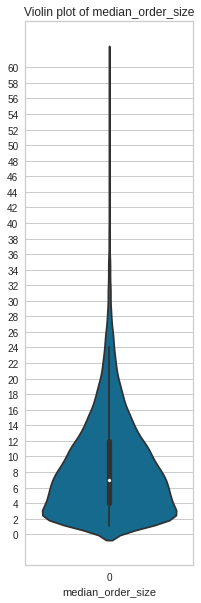

In [ ]:
plt.rcParams["figure.figsize"] = (3, 10)
plt.rcParams["xtick.labelsize"] = 10
ax = sns.violinplot(data = t1["median_order_size"])
ax.set(xlabel='median_order_size',title='Violin plot of median_order_size')
ax.set_yticks(range(0,int(max(t1["median_order_size"].values)),2))
plt.show()

In [ ]:
for p in range(95,101,1):
  print(f"{p}th percentile",int(np.percentile(t["median_order_size"], p)))

95th percentile 15
96th percentile 17
97th percentile 18
98th percentile 19
99th percentile 22
100th percentile 39


In [ ]:
for p in range(95,101,1):
  print(f"{p}th percentile",int(np.percentile(t1["median_order_size"], p)))

95th percentile 21
96th percentile 22
97th percentile 24
98th percentile 26
99th percentile 30
100th percentile 61


**Observation/conclusion**


* Only 10.28% of all our customers order after 26 to 31 days on average
* Only 2.33% of all our customers order after 1 to 4 days on average
*  5% of less frequent customer (order after every 26-30 days) have order sizes greater than 21
*  1% of frequent customer (order after every 1-4 days) have order sizes greater than 21
*  Thus it is safe to say a **customer that has a higher avg order size and that orders more frequently is a better way to determine loyalty**.

eg. 

user1

*   **avg_order_size** = 60
*   **avg_re_order_frquency** = 30
*    will have loyalty value =  2



user2

*   **avg_order_size** = 40
*   **avg_re_order_frquency** = 4
*    will have loyalty value =  10

In [ ]:
# adding avg_order_size_to_re_order_freq_ratio to user loyalty
# There are some avg_reorder_freq  with value 0. We can solve this by adding 1 to avg_reorder_freq. 
# Zeros means month starts on 0 and endson 30th. One means starts on 1 and endson 31th.
user_loyalty_df['avg_reorder_freq'] = user_loyalty_df['avg_reorder_freq']+1
user_loyalty_df['avg_order_size_to_re_order_freq_ratio'] = user_loyalty_df['median_order_size']/user_loyalty_df['avg_reorder_freq']

In [ ]:
user_loyalty_df.head()

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio
0,1,10,5.900000,5.5,21.259259,0.258711
1,2,14,13.928571,13.5,16.967033,0.795661
2,3,12,7.333333,7.0,12.487179,0.560575
3,4,5,3.600000,3.0,16.357143,0.183406
4,5,4,9.250000,10.0,15.500000,0.645161


**avg_order_size_to_re_order_freq_ratio analysis**

In [ ]:
user_loyalty_df[user_loyalty_df["avg_order_size_to_re_order_freq_ratio"]==max(user_loyalty_df["avg_order_size_to_re_order_freq_ratio"].values)]

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio
112043,112044,99,19.363636,20.0,1.40515,14.233358


In [ ]:
user_loyalty_df[user_loyalty_df["avg_order_size_to_re_order_freq_ratio"]==min(user_loyalty_df["avg_order_size_to_re_order_freq_ratio"].values)].iloc[0]

user_id                                  569.000000
num_of_orders                              3.000000
mean_order_szie                            1.000000
median_order_size                          1.000000
avg_reorder_freq                          31.000000
avg_order_size_to_re_order_freq_ratio      0.032258
Name: 568, dtype: float64

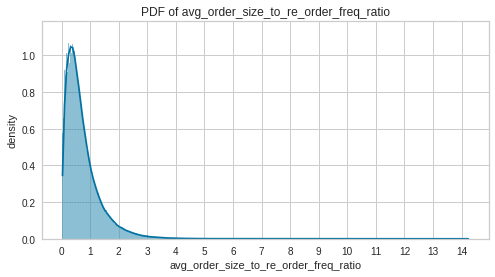

In [ ]:

plt.rcParams["figure.figsize"] = (8, 4)
plt.rcParams["xtick.labelsize"] = 10

ax = sns.histplot(x=user_loyalty_df["avg_order_size_to_re_order_freq_ratio"], stat='density', kde=True)
ax.set(xlabel='avg_order_size_to_re_order_freq_ratio', ylabel='density',title='PDF of avg_order_size_to_re_order_freq_ratio')
ax.set_xticks(range(0, int(max(user_loyalty_df["avg_order_size_to_re_order_freq_ratio"].values))+1, 1))

plt.show()

In [ ]:
#getting users between the 90th and 100th percentile
percentile_range = [0.999,1]
extremely_loyal_customers = user_loyalty_df[(user_loyalty_df["avg_order_size_to_re_order_freq_ratio"]> user_loyalty_df["avg_order_size_to_re_order_freq_ratio"].quantile(percentile_range[0])) & (user_loyalty_df["avg_order_size_to_re_order_freq_ratio"] <= user_loyalty_df["avg_order_size_to_re_order_freq_ratio"].quantile(percentile_range[1]))]
extremely_loyal_customers = extremely_loyal_customers.sort_values(["avg_order_size_to_re_order_freq_ratio"], ascending=[False])

extremely_loyal_customers

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio
112043,112044,99,19.363636,20.0,1.405150,14.233358
115419,115420,3,13.000000,14.0,1.000000,14.000000
100786,100787,99,20.797980,21.0,1.563422,13.432075
54484,54485,99,19.595960,19.0,1.453597,13.071019
9514,9515,3,13.000000,13.0,1.000000,13.000000
...,...,...,...,...,...,...
79177,79178,3,20.666667,22.0,4.500000,4.888889
13669,13670,43,30.651163,33.0,6.753702,4.886209
3290,3291,6,10.666667,9.5,1.948276,4.876106
92234,92235,4,39.250000,39.0,8.000000,4.875000


In [ ]:
#getting ranges
percentile = 99.99
np.percentile(user_loyalty_df["avg_order_size_to_re_order_freq_ratio"], percentile)

8.930539860136129

In [ ]:
(207/tot_users)*100

0.10038359140483685

**Observation/conclusion**

* According to the new feature *avg_order_size_to_re_order_freq_ratio* we created the **most loyal customer on average orders 20 product everyday**. With avg_order_size_to_re_order_freq_ratio = 14.23

* According to the new feature *avg_order_size_to_re_order_freq_ratio* the **most infrequent customer orders only 1 product per month**. With avg_order_size_to_re_order_freq_ratio = 0.0322

* There's only 0.1% of extremely loyal customers that order alot of products almost everyday.

* 25% of users have avg_order_size_to_re_order_freq_ratio < 0.31
* 50% of users have avg_order_size_to_re_order_freq_ratio < 0.56
* 75% of users have avg_order_size_to_re_order_freq_ratio < 0.94
* 90% of users have avg_order_size_to_re_order_freq_ratio < 1.488
* 99% of users have avg_order_size_to_re_order_freq_ratio < 2.95
* 99.99% of users have avg_order_size_to_re_order_freq_ratio < 8.93

In [ ]:
#save to drive
save_csv(df = user_loyalty_df, file_name = 'user_loyalty.csv')
# Save a copy in drive
shutil.copy("/content/dataset/user_loyalty.csv", "/content/drive/MyDrive/assignment datsets")

###**4) Number of aisles ever dabbled in (purchased products).**

In [ ]:
connect_to_drive()

Mounted at /content/drive


In [ ]:
#get user_loyalty dataset from to drive
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_loyalty.csv","/content/user_loyalty.csv")

user_loyalty_df = pd.read_csv("/content/user_loyalty.csv",index_col=0)
user_loyalty_df.head()

'/content/user_loyalty.csv'

In [ ]:
aisles_user_shopped_in_df = merg_df.groupby(["user_id","aisle_id"]).agg({'aisle_id': ['count']})['aisle_id'].reset_index(drop=False)
aisles_user_shopped_in_df.head()

,user_id,aisle_id,count
0,1,21,8
1,1,23,12
2,1,24,5
3,1,45,1
4,1,53,2


In [ ]:
aisles_user_shopped_in_df = aisles_user_shopped_in_df.groupby(["user_id"]).agg({'count': ['count','mean']})['count'].reset_index(drop=False)

In [ ]:
aisles_user_shopped_in_df.rename(columns={'count':'aisles_shopped_in_count','mean':'avg_prods_purchased_per_aisle'}, inplace=True)
aisles_user_shopped_in_df

,user_id,aisles_shopped_in_count,avg_prods_purchased_per_aisle
0,1,12,4.916667
1,2,33,5.909091
2,3,16,5.500000
3,4,14,1.285714
4,5,16,2.312500
...,...,...,...
206204,206205,17,1.882353
206205,206206,50,5.700000
206206,206207,46,4.847826
206207,206208,63,10.746032


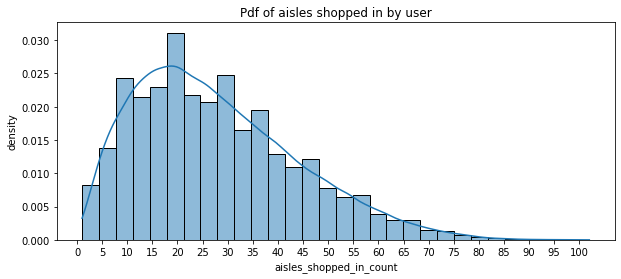

In [ ]:

plt.rcParams["figure.figsize"] = (10, 4)
plt.rcParams["xtick.labelsize"] = 10

ax = sns.histplot(x= aisles_user_shopped_in_df["aisles_shopped_in_count"],stat='density', kde=True,bins = 30)
ax.set(xlabel='aisles_shopped_in_count', ylabel='density',title='Pdf of aisles shopped in by user')
ax.set_xticks(range(0, max(aisles_user_shopped_in_df["aisles_shopped_in_count"].values), 5))
plt.show()

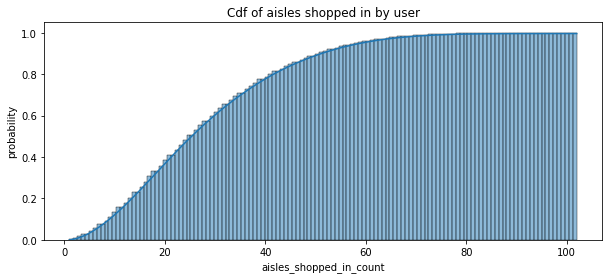

In [ ]:
ax =sns.histplot( aisles_user_shopped_in_df["aisles_shopped_in_count"], stat='probability',cumulative = True, kde=True)
ax.set(xlabel='aisles_shopped_in_count', ylabel='probability',title='Cdf of aisles shopped in by user')
plt.show()

**Observation/Conclusion**

* Count of  Aisles shopped in can potentially determine loyalty as the more number of aisles a person shops in, the more variety of products he/she purchases, which is key in increasing revenue.
* But also if a customer dabbles in many aisles but buys very few products per ailse, this could mean the customer doesnt come to instacart with a sole purpose of buying a specify type of item or doesnt have a meticulously planned grocery liss, but lets whimsy guide their grazing.
* Thus average products purchased per aisle would be a better metric to just loyalty.
* With this metric a person that dabbles in a few ailse but purchases alot of products per ailse will be given a higher value.
* These users are loyal to only a handful of ailses thus bringing them back to the app more frequently.
* A customer with a lower **average products purchased per aisle** ratio may not be loyal to specific aisles i.e they are not hooked on to any ailse, so if they do not find anything that interests them, they could potentially use the app less frequenty.

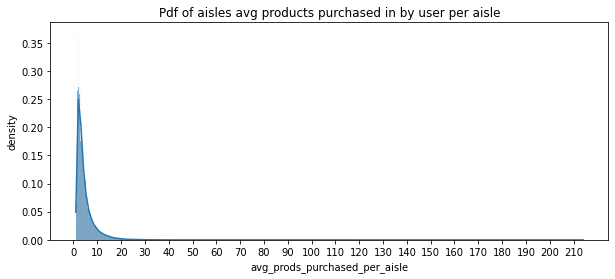

In [ ]:

plt.rcParams["figure.figsize"] = (10, 4)
plt.rcParams["xtick.labelsize"] = 10

ax = sns.histplot(x= aisles_user_shopped_in_df["avg_prods_purchased_per_aisle"],stat='density', kde=True)
ax.set(xlabel='avg_prods_purchased_per_aisle', ylabel='density',title='Pdf of aisles avg products purchased in by user per aisle')
ax.set_xticks(range(0, round(max(aisles_user_shopped_in_df["avg_prods_purchased_per_aisle"].values)), 10))
plt.show()

In [ ]:
#merging the feature
user_loyalty_df = pd.merge(user_loyalty_df, aisles_user_shopped_in_df, on='user_id', how='left')
user_loyalty_df.head()

In [ ]:
user_loyalty_df[user_loyalty_df['avg_prods_purchased_per_aisle']>100].sort_values(['avg_prods_purchased_per_aisle'],ascending=False)

,user_id,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle
82413,82414,92,4.652174,5.0,2.995272,1.669298,2,214.000000
100697,100698,73,17.452055,18.0,5.945860,3.027317,6,212.333333
103592,103593,99,14.313131,13.0,5.107473,2.545290,7,202.428571
86343,86344,83,2.385542,2.0,5.338462,0.374640,1,198.000000
99752,99753,99,1.929293,2.0,4.402116,0.454327,1,191.000000
75123,75124,99,16.383838,16.0,2.752809,5.812245,9,180.222222
109601,109602,40,4.125000,4.0,8.583851,0.465991,1,165.000000
147196,147197,51,9.431373,9.0,8.131356,1.106826,3,160.333333
22599,22600,22,6.863636,7.0,16.726027,0.418509,1,151.000000
39900,39901,99,19.353535,19.0,3.643119,5.215312,13,147.384615


In [ ]:
(len(user_loyalty_df[user_loyalty_df['avg_prods_purchased_per_aisle']>100])/tot_users)*100

0.012123622150342614

**Observation/conclusion**

* There are 0.01% of customers that purchase on avg more than 100 items per ailse.
* The person with the highest ratio purchases 214 products per ailse he shops in, which is only 2 i.e he is extremely loyal to only 2 ailses. Also he has placed a whopping 92 orders so far and orders after every 3 days with an avg order size of 5.

In [ ]:
#save to drive
user_loyalty_df.to_csv('user_loyalty.csv')
shutil.copy("/content/dataset/user_loyalty.csv", "/content/drive/MyDrive/assignment datsets")

'/content/drive/MyDrive/assignment datsets/user_loyalty.csv'

###**Clustering Customers based on loyalty.**

In [20]:
import shutil
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


In [21]:
#get user_loyalty dataset from to drive
shutil.copy( "/content/drive/MyDrive/assignment datsets/user_loyalty.csv","/content/user_loyalty.csv")

user_loyalty_df = pd.read_csv("/content/user_loyalty.csv", index_col=0)
user_loyalty_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 206209 entries, 1 to 206209
Data columns (total 10 columns):
 #   Column                                 Non-Null Count   Dtype  
---  ------                                 --------------   -----  
 0   num_of_orders                          206209 non-null  int64  
 1   mean_order_szie                        206209 non-null  float64
 2   median_order_size                      206209 non-null  float64
 3   avg_reorder_freq                       206209 non-null  float64
 4   avg_order_size_to_re_order_freq_ratio  206209 non-null  float64
 5   aisles_shopped_in_count                206209 non-null  int64  
 6   avg_prods_purchased_per_aisle          206209 non-null  float64
 7   cluster_3                              206209 non-null  int64  
 8   cluster_4                              206209 non-null  int64  
 9   cluster_5                              206209 non-null  int64  
dtypes: float64(5), int64(5)
memory usage: 17.3 MB


In [22]:
user_loyalty_df.head()

,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
user_id,,,,,,,,,,
1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4
2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0
3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4
4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4
5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4


**K-Means: Inertia**

* Inertia measures how well a dataset was clustered by K-Means. It is calculated by measuring the distance between each data point and its centroid, squaring this distance, and summing these squares across one cluster.

* A good model is one with low inertia AND a low number of clusters (K). However, this is a tradeoff because as K increases, inertia decreases.


In [23]:
num_clusters = 10
sse=[]
sil_score = []
for i in range(1,num_clusters):
  kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0)
  kmeans.fit(user_loyalty_df)
  sse_iter = kmeans.inertia_
  sse.append(sse_iter)
  print(f"clsuter {i} Done")



clsuter 1 Done
clsuter 2 Done
clsuter 3 Done
clsuter 4 Done
clsuter 5 Done
clsuter 6 Done
clsuter 7 Done
clsuter 8 Done
clsuter 9 Done


In [56]:
%matplotlib inline

In [57]:


import matplotlib
import numpy as np
import matplotlib.pyplot as plt

In [58]:
%matplotlib inline

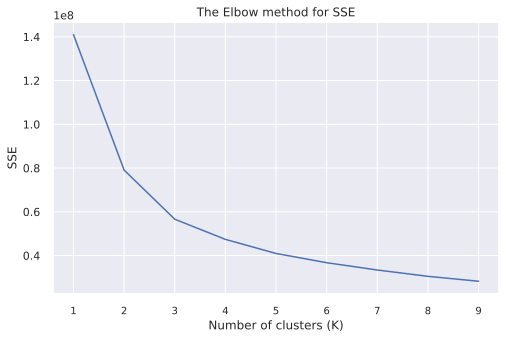

In [59]:
plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["xtick.labelsize"] = 10

ax = plt.subplot(111)


number_clusters = range(1,num_clusters)
ax.plot(number_clusters,sse)
ax.set(xlabel='Number of clusters (K)', ylabel='SSE',title='The Elbow method for SSE', xticks = number_clusters)
plt.show()

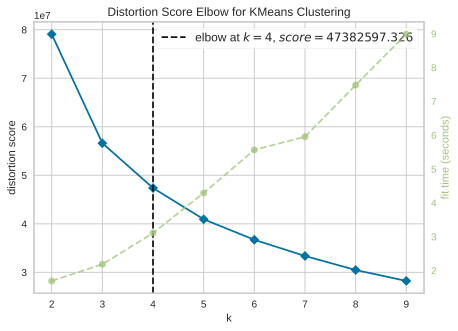

In [ ]:
#https://www.scikit-yb.org/en/latest/api/cluster/elbow.html
plt.rcParams["figure.figsize"] = (7, 5)
plt.rcParams["xtick.labelsize"] = 10

kmeans = KMeans(n_clusters = i, init='k-means++', verbose = 0, random_state=4)
visualizer = KElbowVisualizer(kmeans, k=(2,10),locate_elbow= True, verbose = 1)

visualizer.fit(user_loyalty_df)        # Fit the data to the visualizer
visualizer.show()                      # Finalize and render the figure

**Observation/conclusion**

*  It is a common practice to implement K-means clustering on +/- 1 of optimal cluster identified; here, it is 3, 4, and 5 clusters.


* This gives a wider perspective and facilitates meaningful discussion with your stakeholders to determine the appropriate number of customers segments.

* Perhaps there could be some market peculiarities and your stakeholders might decide to implement their marketing strategies on 5 clusters instead of the optimal 4 clusters identified.
https://towardsdatascience.com/the-most-important-data-science-tool-for-market-and-customer-segmentation-c9709ca0b64a


* Using Elbow method K=3 or 4 or 5 seems to be a good choice and is also an intuitive number of clusters for the given problem.


In [ ]:
chosen_k = [3,4,5]
for k in chosen_k:
  kmeans = KMeans(n_clusters = k, init='k-means++', verbose = 0, random_state = 0)
  kmeans.fit(user_loyalty_df)
  pred_cluster_labels = kmeans.labels_
  cluster = f'cluster_{k}'
  user_loyalty_df[cluster] = pred_cluster_labels

# Extract cluster labels
user_loyalty_df.head()

,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
user_id,,,,,,,,,,
1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,3,0
2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,0,4
3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,3,0
4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,3,0
5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,3,0


**How does the end result of K-means segmentation look like?**

**TSNE**

In [ ]:
def tsne_plot(X,Y):
  """
  Tsne visualization plot
  """
  tsne  = TSNE(random_state=1, perplexity=2000, n_iter=2000)
  tsne_results  = tsne.fit_transform(X)

  # Plot t-SNE
  sns.scatterplot(x=tsne_results[:,0], y=tsne_results[:,1], hue= Y,style= Y, palette="Set1",data = X,alpha=0.7)

  plt.show()

In [ ]:
from sklearn.model_selection import train_test_split
# Since t-sne on the entire dataset took too long, 
# stratified sampling of points according to predicted clusters was done and only a subset of the entire dataset was used
plt.rcParams["figure.figsize"] = (8, 6)
plt.rcParams["xtick.labelsize"] = 10


X_train, X_test_3, y_train, y_test_3 = train_test_split( user_loyalty_df.values, user_loyalty_df["cluster_3"].values, test_size=0.025, stratify = user_loyalty_df["cluster_3"].values, random_state=42)
X_train, X_test_4, y_train, y_test_4 = train_test_split( user_loyalty_df.values, user_loyalty_df["cluster_4"].values, test_size=0.025, stratify = user_loyalty_df["cluster_4"].values, random_state=42)
X_train, X_test_5, y_train, y_test_5 = train_test_split( user_loyalty_df.values, user_loyalty_df["cluster_5"].values, test_size=0.025, stratify = user_loyalty_df["cluster_5"].values, random_state=42)


print("X_train", X_train.shape)
print("y_train", y_train.shape)
print("X_test", X_test_3.shape)
print("y_test", y_test_3.shape)


# Initialise TSNE

tsne_plot(X_test_3, y_test_3)
tsne_plot(X_test_4, y_test_4)
tsne_plot(X_test_5,y_test_5)



X_train (201053, 10)
y_train (201053,)
X_test (5156, 10)
y_test (5156,)


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



**PCA**

In [ ]:
colors = ["#7CFC00","#FF5733","#228B22","#FFC300"]
cluster_names = ['regulars','new/unhappy','loyal','bulk']

In [ ]:
from sklearn.decomposition import PCA
import plotly.express as px
def pca_plot(X,Y):
    """
    PCA visualization plot
    """


    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(X)

    pca = PCA(n_components=3)
    pca_result = pca.fit_transform(x_scaled)

    # Plot 2d t-SNE
    # sns.scatterplot(x=pca_result[:,0], y=pca_result[:,1], hue= Y,style= Y, palette="Set1",data = X,alpha=0.7)
    # plt.show()

    # Plot 3d  t-SNE
    total_var = pca.explained_variance_ratio_.sum() * 100
    fig = px.scatter_3d(
    pca_result, x=0, y=1, z=2, color=Y,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels=cluster_names)
    fig.show()

In [ ]:
pca_plot(X_test_3, y_test_3)
pca_plot(X_test_4, y_test_4)
pca_plot(X_test_5,y_test_5)

**Observation/conclusion**

*  The Cluaters seem to be well separated with very little overlap. The 3 features reduced from the initial7 explain 91% of the total variance for 4 clusters.
* Thus the features created help us in identifying distinct clusters. 


###**Analyse each cluster (BASIC)**

In [ ]:
user_loyalty_df.head()

,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_3,cluster_4,cluster_5
user_id,,,,,,,,,,
1,10,5.900000,5.5,21.259259,0.258711,12,4.916667,1,1,4
2,14,13.928571,13.5,16.967033,0.795661,33,5.909091,2,3,0
3,12,7.333333,7.0,12.487179,0.560575,16,5.500000,1,1,4
4,5,3.600000,3.0,16.357143,0.183406,14,1.285714,1,1,4
5,4,9.250000,10.0,15.500000,0.645161,16,2.312500,1,1,4


In [ ]:
cluster_counts = user_loyalty_df.groupby(["cluster_4"]).agg({'cluster_4': ['count']})['cluster_4'].reset_index(drop=False)
cluster_counts

,cluster_4,count
0,0,37409
1,1,85987
2,2,13216
3,3,69597


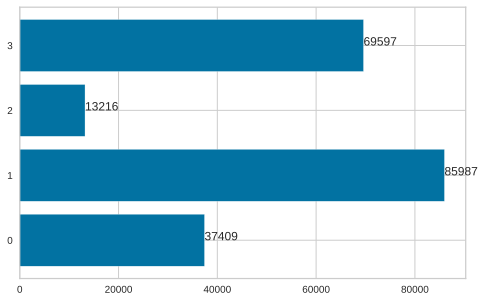

In [ ]:
plt.rcParams["figure.figsize"] = (8, 5)
plt.rcParams["xtick.labelsize"] = 10

x = cluster_counts['cluster_4']
y = cluster_counts['count']
plt.barh(x, y)
 
for index, value in enumerate(y):
    plt.text(value, index,
             str(value))
plt.yticks(x)
plt.show()

**Observation/Conclusion**

*  Cluster 0 has 37,409 customers.
*  Cluster 1 is the largest cluster with 85,987 customers.
*  Cluster 2 has the least number of people in it i.e. 13,216 customer.
*  Cluster 3 has  69,597 customers.

In [ ]:
# source  https://medium.com/web-mining-is688-spring-2021/using-k-means-to-segment-customers-based-on-rfm-variables-9d4d683688c8

def snake_plot(X,y):

    #normalise df
    import pandas as pd
    from sklearn import preprocessing

    x = X.reset_index().drop( ["user_id"],axis = 1).values
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    normalised_df = pd.DataFrame(x_scaled)
    normalised_df.columns = X.columns.values
    normalised_df['cluster_belonging_to'] = y.values


    # Melt data into long format
    df_melt = pd.melt(normalised_df, id_vars=['cluster_belonging_to'],
                            value_vars= X.columns.values, 
                            var_name='Metric', 
                            value_name='Value')
    
    plt.rcParams["figure.figsize"] = (18, 6)
    plt.rcParams["xtick.labelsize"] = 10


    plt.xlabel('Metric')
    plt.ylabel('Value')
    ax = sns.pointplot(data= df_melt, x='Metric', y='Value', hue='cluster_belonging_to')
    ax.set_xticklabels(ax.get_xticklabels(), rotation=30, fontsize=10)
    ax.set_title("Snake plot of how all 3 clusters performed on the features")
    plt.show()
    return



In [ ]:
# normalised_df.head()

,num_of_orders,mean_order_szie,median_order_size,avg_reorder_freq,avg_order_size_to_re_order_freq_ratio,aisles_shopped_in_count,avg_prods_purchased_per_aisle,cluster_belonging_to
0,0.072917,0.070758,0.062069,0.675309,0.015946,0.108911,0.018388,1
1,0.114583,0.186694,0.172414,0.532234,0.053757,0.316832,0.023047,2
2,0.093750,0.091456,0.082759,0.382906,0.037203,0.148515,0.021127,1
3,0.020833,0.037545,0.027586,0.511905,0.010643,0.128713,0.001341,1
4,0.010417,0.119134,0.124138,0.483333,0.043159,0.148515,0.006162,1


In [ ]:
# df_melt.head()

,cluster_belonging_to,Metric,Value
0,1,num_of_orders,0.072917
1,2,num_of_orders,0.114583
2,1,num_of_orders,0.093750
3,1,num_of_orders,0.020833
4,1,num_of_orders,0.010417


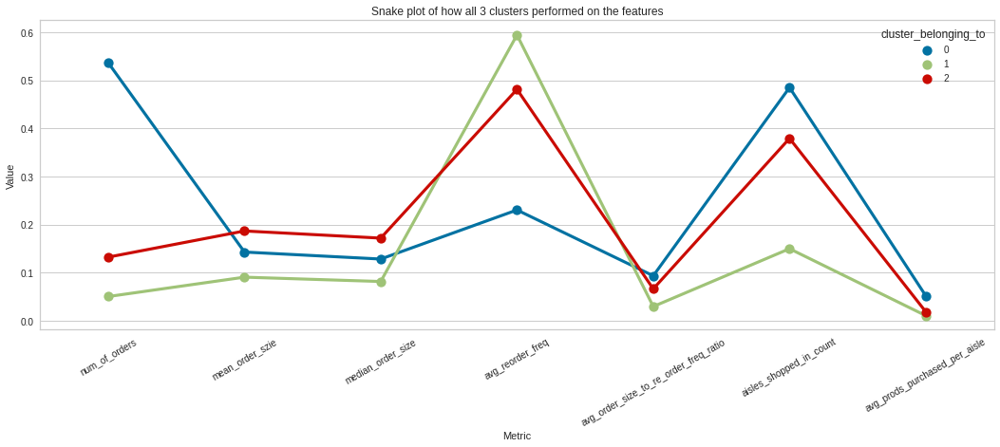

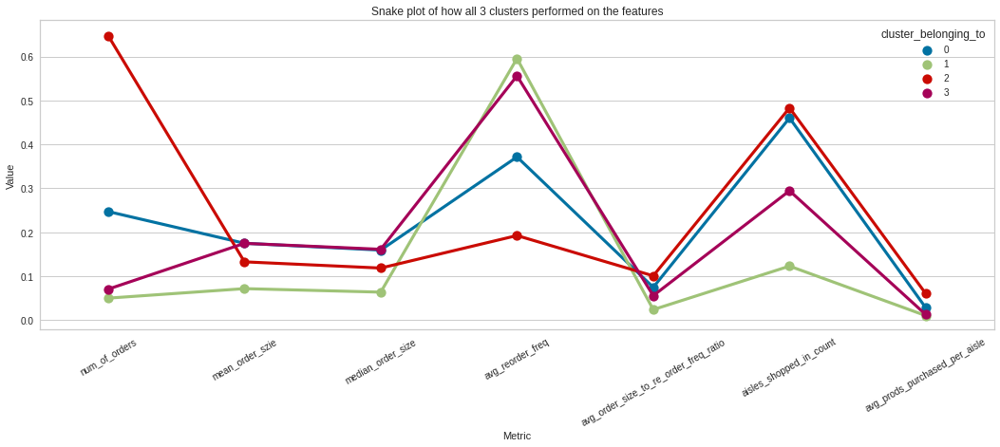

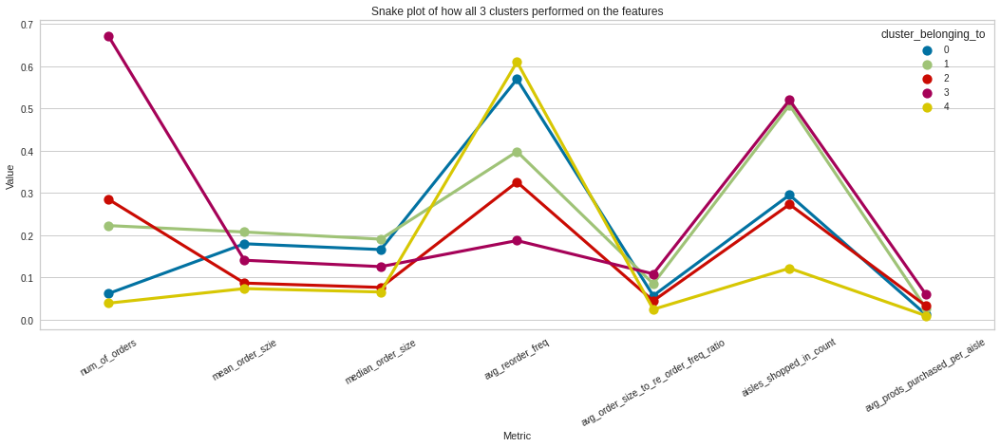

In [ ]:
snake_plot(user_loyalty_df.iloc[:,0:-3], user_loyalty_df.iloc[:,-3:-2])
snake_plot(user_loyalty_df.iloc[:,0:-3], user_loyalty_df.iloc[:,-2:-1])
snake_plot(user_loyalty_df.iloc[:,0:-3], user_loyalty_df.iloc[:,-1:])

**4 Clusters seem to be the best split**


**Cluster 0 ---> (REGULARS)**

*  Cluster 0 has 37,409 customers.
* These customers have placed a good amount of orders since they reorder regularly and have a good order size.
* They have explored instacart alot as they have shopped in alot of aisles previously.
* **Regular customers**
* Who could they be? Regular shoppers, General wholesale stores. 



**Cluster 1 ---> (NEW/UNHAPPY)**


*  Cluster 1 is the largest cluster with 85,987 customers.
* These customers have placed the least amount of orders since they reorder very infrequently with the lowest order size.
* They haven't explored instacart alot as they have shooped in the least number of aisles.
* **New or unhappy customers**
* Who could they be? First timers, customers that had a bad experience with the app, customers that prefer offline grocery shopping.

**Cluster 2 ---> (LOYAL)**

*  Cluster 2 has the least number of people in it i.e 13,216 customer.

* These have placed the largest amount of orders as they order very frquently with medium to large order sizes.
* They have shopped in the most number of ailes. This could mean these| are old customers that have explored instacart in and out over the years BUT they do the majority of their daily shopping in only a few ailes.
* **Customers that shop very frquently with a good order size, they are also loyal to only a few ailses (i.e they purchase alot of products from only few aisles)**
* Who could they be? Fast moving restaurants, new businesses.


**Cluster 3 ---> (INFREQUENT BULK ORDERERS)** 


*  Cluster 3 has  69,597 customer.
* These have placed a low amount of orders as they order in-frequently with the largest order sizes.
* They have also shopped in alot of aisles and are not loyal to any specific aisle but like to shop in general.
* **Customers that order in-frequently, but when they order they order in bulk**
* Who could they be?  Customers that hoard and store products for a long time.

**Cluster average, min and max stats**

In [ ]:
pd.set_option('display.max_columns', None)
user_loyalty_df.groupby(["cluster_4"]).agg(['mean','min','max'])

num_of_orders         mean_order_szie                   \
                   mean min max            mean    min       max   
cluster_4                                                          
0             26.733139   4  47       13.122723  1.425  70.25000   
1              7.822357   3  51        5.976490  1.000  22.00000   
2             65.137788  37  99       10.197063  1.000  56.84375   
3              9.789675   3  34       13.111683  2.120  57.25000   

          median_order_size            avg_reorder_freq                       \
                       mean  min   max             mean       min        max   
cluster_4                                                                      
0                 12.565319  1.0  73.5        12.144490  2.080357  31.000000   
1                  5.631601  1.0  23.0        18.862939  1.000000  31.000000   
2                  9.602262  1.0  54.5         6.778690  1.288591  11.547644   
3                 12.696086  1.0  61.0        17.677862  1.578947  31.000000   

          avg_order_size_to_re_order_freq_ratio                       \
                                           mean       min        max   
cluster_4                                                              
0                                      1.094784  0.064632   9.289309   
1                                      0.374718  0.032258  14.000000   
2                                      1.465991  0.106540  14.233358   
3                                      0.825787  0.033996  12.500000   

          aisles_shopped_in_count          avg_prods_purchased_per_aisle  \
                             mean min  max                          mean   
cluster_4                                                                  
0                       47.483119  13  102                      7.002528   
1                       13.430205   1   27                      3.217825   
2                       49.795702   1  102                     13.853461   
3                       30.748883  10   56                      3.717717   

                                cluster_3         cluster_5          
                min         max      mean min max      mean min max  
cluster_4                                                            
0          1.666667   42.125000  1.514021   0   2  1.255206   0   3  
1          1.000000  151.000000  0.999174   0   1  3.891542   0   4  
2          2.966667  214.000000  0.000000   0   0  2.847458   1   3  
3          1.115385   47.071429  1.617081   1   2  0.163599   0   2

In [ ]:
#save to drive
save_csv(user_loyalty_df, 'user_loyalty.csv')

shutil.copy("/content/dataset/user_loyalty.csv", "/content/drive/MyDrive/assignment datsets")

###**Analyse each cluster (In depth)**

**Which day of hour does each group like to shop on?**

In [17]:
#get user_loyalty dataset from to drive

connect_to_drive()

shutil.copy( "/content/drive/MyDrive/assignment datsets/user_loyalty.csv","/content/user_loyalty.csv")

user_loyalty_df = pd.read_csv("/content/user_loyalty.csv",index_col=0)
user_loyalty_df.head()

In [15]:
# Get and load data before running this ^
#                                       |

orders_prior = orders_df[orders_df['eval_set'] == 'prior']
merg_df = pd.merge(
              pd.merge(
                   pd.merge(
                       pd.merge(
                           order_prod_pr_df, 
                           orders_prior,on='order_id',
                           how='left')
                   ,products_df, on='product_id',how='left')
               ,aisle_df, on='aisle_id',how='left')
          ,dept_df, on='department_id',how='left')

merg_df.sort_values(["user_id","order_id","product_id"], ascending=[True,True,False],inplace=True)
merg_df.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
4089404,431534,41787,7,0,1,prior,5,4,15,28.0,Bartlett Pears,24,4,fresh fruits,produce
4089401,431534,25133,4,1,1,prior,5,4,15,28.0,Organic String Cheese,21,16,packaged cheese,dairy eggs
4089403,431534,17122,6,0,1,prior,5,4,15,28.0,Honeycrisp Apples,24,4,fresh fruits,produce
4089405,431534,13176,8,1,1,prior,5,4,15,28.0,Bag of Organic Bananas,24,4,fresh fruits,produce
4089399,431534,12427,2,1,1,prior,5,4,15,28.0,Original Beef Jerky,23,19,popcorn jerky,snacks


In [ ]:
merg_df= pd.merge(merg_df, user_loyalty_df.reset_index()[['user_id','cluster_4']] ,on='user_id',how='left')
merg_df.head()

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department,cluster_4
0,431534,41787,7,0,1,prior,5,4,15,28.0,Bartlett Pears,24,4,fresh fruits,produce,1
1,431534,25133,4,1,1,prior,5,4,15,28.0,Organic String Cheese,21,16,packaged cheese,dairy eggs,1
2,431534,17122,6,0,1,prior,5,4,15,28.0,Honeycrisp Apples,24,4,fresh fruits,produce,1
3,431534,13176,8,1,1,prior,5,4,15,28.0,Bag of Organic Bananas,24,4,fresh fruits,produce,1
4,431534,12427,2,1,1,prior,5,4,15,28.0,Original Beef Jerky,23,19,popcorn jerky,snacks,1


In [ ]:
colors = ["#7CFC00","#FF5733","#228B22","#FFC300"]
cluster_names = ['regulars','new/unhappy','loyal','bulk']

In [ ]:
avg_hod_user  = merg_df.groupby(["cluster_4","user_id"]).agg({'order_hour_of_day': ['mean']})['order_hour_of_day'].reset_index(drop=False)
avg_hod_user.head()

,cluster_4,user_id,mean
0,0,14,8.952381
1,0,17,13.496599
2,0,19,13.803922
3,0,21,10.814634
4,0,28,14.967213


regulars cluster generally shops between 10 to 17
new/unhappy cluster generally shops between 9 to 18
loyal cluster generally shops between 10 to 16
bulk cluster generally shops between 9 to 18


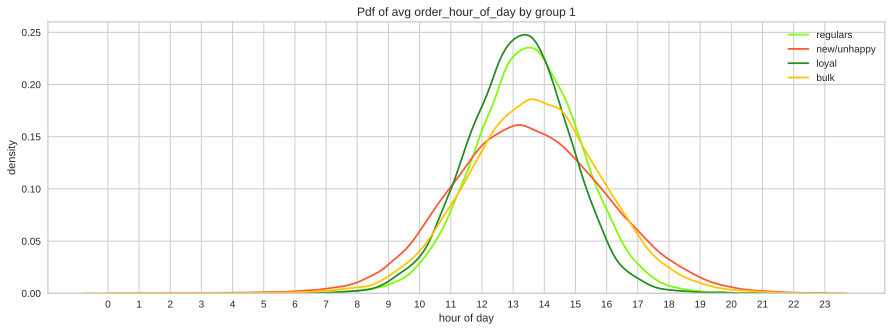

In [ ]:


plt.rcParams["figure.figsize"] = (12, 5)
plt.rcParams["xtick.labelsize"] = 10
confidence = 0.95
fig, axes = plt.subplots()

for grp in range(0,4):
    x = avg_hod_user[avg_hod_user["cluster_4"]==grp]['mean']
    ax = sns.distplot(x= x, kde=True, bins = 24, ax = axes, hist = False, color = colors[grp])
    c_i = np.percentile(x, [100*(1-confidence)/2,100*(1-(1-confidence)/2)])
    print(f"{cluster_names[grp]} cluster generally shops between {round(c_i[0])} to {round(c_i[1])}")

ax.legend(cluster_names,fontsize=10)
ax.set(xlabel='hour of day', ylabel='density',title='Pdf of avg order_hour_of_day by group 1')
ax.set_xticks(range(0, round(max(x.values))+1, 1))
plt.show()

In [ ]:
#https://stackoverflow.com/questions/41924767/matplotlib-can-i-interrupt-an-axhline-with-text
plt.rcParams["figure.figsize"] = (12, 5)
plt.rcParams["xtick.labelsize"] = 10

fig, axes = plt.subplots(1,4)

for grp in range(0,4):
    x =avg_hod_user[avg_hod_user["cluster_4"]==grp]['mean']
    stats.probplot(x, dist="norm", plot=axes[grp])
    axes[grp].set_title(cluster_names[grp], fontsize=17)
    axes[grp].set_yticks(range(0,24,2))
    axes[grp].axhline(y=np.mean(x), color='g', linestyle='-')

plt.show()

KstestResult(statistic=0.007908518708743484, pvalue=0.018567907299165652)
KstestResult(statistic=0.011530493151813537, pvalue=2.3505845216625087e-10)
KstestResult(statistic=0.0108834000264586, pvalue=0.08735594565184536)
KstestResult(statistic=0.006767013439162861, pvalue=0.00341052167035565)


**Observation/conclusion**

* The above QQ-plot shows that only frequent/loyal user shop some what evenly throughout the day.

 Bulk orderers clearly have a left skewed ditribution i.e there are only a handful of them that shop early morning.

 Regular customer hour of day shopping distribution has some **kurtosis** i.e there are a few customers (outliers) beloning to this group that shop very early in the morning and late at night.



* The **frequent/loyal** customer generally shops between 10am to 4pm with 95% confidence. They generally end shopping the earlier compared to other groups i.e by 5pm. Their Peak hours [12:30pm to 2pm]


* The **Bulk orderers** generally shops between 9am to 6pm with 95% confidence. They shop on the app till late. Their Peak hours [1pm to 2.30pm]


* **Regular customers** generally shop between 10 to 5pm with 95% confidence. Peak hours [12:30am to 2pm]


* **new/unhappy** generally shops between 9am to 18pm with 95% confidence. Peak hours [12am to 2pm]


In [ ]:
# #https://github.com/sukhdev01/Central-Limit-Theorem/blob/master/Central_Limit_Theorem.ipynb
# def apply_CLT(sample_data,sample_size,total_samples):
#   sample_mean = []
#   for a in range(total_samples):  #iterating for total no of samples for choosing samples and their mean
#     sample = np.random.choice(sample_data, size = sample_size)    #Note:- replace=False for with-out replacement
#     mean = np.mean(sample)      #Finding mean of random chose samples using numpy
#     sample_mean.append(mean)     
     
#   return sample_mean


# sample_data =temp[temp["cluster_4"]==1]['mean']
# x = apply_CLT(sample_data,sample_size = 30, total_samples = 1000)

# stats.probplot(x, dist="norm", plot=plt)
# plt.show()
# # create 90% confidence interval
# stats.t.interval(alpha=0.99, df=len(x)-1,
#               loc=np.mean(x),
#               scale=stats.sem(x))

**Which hour of day does each group like to shop during.**

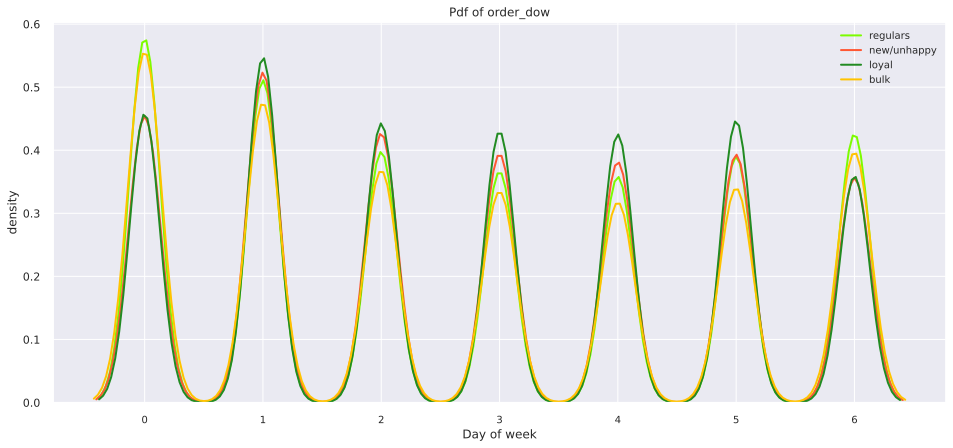

In [ ]:

plt.rcParams["figure.figsize"] = (16, 7)
plt.rcParams["xtick.labelsize"] = 10

fig, axes = plt.subplots()

temp  = merg_df.groupby(["cluster_4","order_id"], observed=True).first().reset_index(drop=False)

for grp in range(0,4):
    x = temp[temp["cluster_4"]==grp]['order_dow']
    ax = sns.distplot(x= x, kde=True, bins = 7, ax = axes, hist = False,label=grp, color =colors[grp], kde_kws=dict(linewidth=2))

ax.legend(cluster_names,fontsize=10)
ax.set(xlabel='Day of week', ylabel='density',title='Pdf of order_dow')

plt.show()

**Observation/conclusion**

* Looking at these peaks it can be assumed that 0=Saturday and 6=Sunday. So customer shop on weekends more.
* Loyal customer shop alot on sundays and the least on fridays.
* Bulk orderers/ new or unhappy shoppers shop the most on the weekends
*  Regular customers shop almost evenly all week around but the most on saturdays.


**What do they typically buy Aisle wise**

In [ ]:
import pprint

aisle = []
for grp in range(0,4):
    aisles_per_cluster = merg_df[merg_df["cluster_4"]==grp]['aisle'].values

    unique, counts = np.unique(aisles_per_cluster, return_counts=True)
    d = dict(zip(unique, counts))

    s = sum(d.values())
    for k, v in d.items():
        d[k] = (round(v * 100.0 / s,2),v)
    print(f"Clsuter {grp}")
    aisle.append(sorted(d.items(), key=lambda x: x[1], reverse = True)[:10])
    pprint.pprint(aisle[grp])
    print("\n*******************************************************************")

Clsuter 0
[('fresh vegetables', (10.58, 1303211)),
 ('fresh fruits', (10.51, 1293855)),
 ('packaged vegetables fruits', (5.32, 654655)),
 ('yogurt', (4.37, 538581)),
 ('packaged cheese', (3.18, 392095)),
 ('milk', (2.57, 315984)),
 ('chips pretzels', (2.29, 281767)),
 ('water seltzer sparkling water', (2.29, 281500)),
 ('soy lactosefree', (1.87, 229747)),
 ('bread', (1.84, 226722))]

*******************************************************************
Clsuter 1
[('fresh fruits', (12.28, 437713)),
 ('fresh vegetables', (9.03, 321585)),
 ('packaged vegetables fruits', (5.42, 193140)),
 ('water seltzer sparkling water', (4.18, 148774)),
 ('yogurt', (3.94, 140293)),
 ('packaged produce', (3.4, 121233)),
 ('milk', (2.95, 105201)),
 ('packaged cheese', (2.39, 85071)),
 ('chips pretzels', (2.16, 76841)),
 ('soy lactosefree', (2.02, 72112))]

*******************************************************************
Clsuter 2
[('fresh fruits', (12.63, 1086899)),
 ('fresh vegetables', (10.48, 902231)),

**What do they typically buy Department wise ?**

In [ ]:
import pprint

dept = []
for grp in range(0,4):
    dept_per_cluster = merg_df[merg_df["cluster_4"]==grp]['department'].values

    unique, counts = np.unique(dept_per_cluster, return_counts=True)
    d = dict(zip(unique, counts))

    s = sum(d.values())
    for k, v in d.items():
        d[k] = (round(v * 100.0 / s,2),v)
    print(f"Clsuter {grp}")
    dept.append(sorted(d.items(), key=lambda x: x[0], reverse = False)[:21])
    pprint.pprint(dept[grp])
    print("\n*******************************************************************")

Clsuter 0
[('alcohol', (0.41, 50231)),
 ('babies', (1.43, 175742)),
 ('bakery', (3.79, 466832)),
 ('beverages', (7.75, 954624)),
 ('breakfast', (2.21, 272427)),
 ('bulk', (0.09, 11629)),
 ('canned goods', (3.59, 442408)),
 ('dairy eggs', (16.57, 2039959)),
 ('deli', (3.32, 408439)),
 ('dry goods pasta', (2.95, 363366)),
 ('frozen', (7.29, 897860)),
 ('household', (2.37, 291447)),
 ('international', (0.9, 110546)),
 ('meat seafood', (2.35, 289710)),
 ('missing', (0.22, 26515)),
 ('other', (0.11, 13796)),
 ('pantry', (6.03, 742821)),
 ('personal care', (1.45, 178073)),
 ('pets', (0.34, 41763)),
 ('produce', (28.03, 3452156)),
 ('snacks', (8.8, 1084102))]

*******************************************************************
Clsuter 1
[('alcohol', (1.1, 39340)),
 ('babies', (0.61, 21897)),
 ('bakery', (2.97, 105992)),
 ('beverages', (11.22, 399949)),
 ('breakfast', (2.1, 74865)),
 ('bulk', (0.11, 3958)),
 ('canned goods', (2.42, 86060)),
 ('dairy eggs', (15.4, 548776)),
 ('deli', (2.86, 101

In [ ]:
# Getting most shopped dept in descending order.
dept_all_cluster = merg_df['department'].values

unique, counts = np.unique(dept_all_cluster, return_counts=True)
d = dict(zip(unique, counts))

s = sum(d.values())
for k, v in d.items():
    d[k] = (round(v * 100.0 / s,2), v)

all_dept_sorted = sorted(d.items(), key=lambda x: x[1], reverse = True)[:22]
all_dept_sorted = [t for t in list(dict(all_dept_sorted).keys())]
all_dept_sorted

['produce',
 'dairy eggs',
 'snacks',
 'beverages',
 'frozen',
 'pantry',
 'bakery',
 'canned goods',
 'deli',
 'dry goods pasta',
 'household',
 'breakfast',
 'meat seafood',
 'personal care',
 'babies',
 'international',
 'alcohol',
 'pets',
 'missing',
 'other',
 'bulk']

In [ ]:
# Sort all cluster departments based on overall department order 
for i, d in enumerate(dept):
  ordered_dict_items = [(k,dict(d)[k]) for k in all_dept_sorted]
  dept[i] = ordered_dict_items
dept

[[('produce', (28.03, 3452156)),
  ('dairy eggs', (16.57, 2039959)),
  ('snacks', (8.8, 1084102)),
  ('beverages', (7.75, 954624)),
  ('frozen', (7.29, 897860)),
  ('pantry', (6.03, 742821)),
  ('bakery', (3.79, 466832)),
  ('canned goods', (3.59, 442408)),
  ('deli', (3.32, 408439)),
  ('dry goods pasta', (2.95, 363366)),
  ('household', (2.37, 291447)),
  ('breakfast', (2.21, 272427)),
  ('meat seafood', (2.35, 289710)),
  ('personal care', (1.45, 178073)),
  ('babies', (1.43, 175742)),
  ('international', (0.9, 110546)),
  ('alcohol', (0.41, 50231)),
  ('pets', (0.34, 41763)),
  ('missing', (0.22, 26515)),
  ('other', (0.11, 13796)),
  ('bulk', (0.09, 11629))],
 [('produce', (30.97, 1103593)),
  ('dairy eggs', (15.4, 548776)),
  ('snacks', (9.49, 338197)),
  ('beverages', (11.22, 399949)),
  ('frozen', (6.42, 228891)),
  ('pantry', (5.11, 181933)),
  ('bakery', (2.97, 105992)),
  ('canned goods', (2.42, 86060)),
  ('deli', (2.86, 101988)),
  ('dry goods pasta', (1.76, 62599)),
  ('h

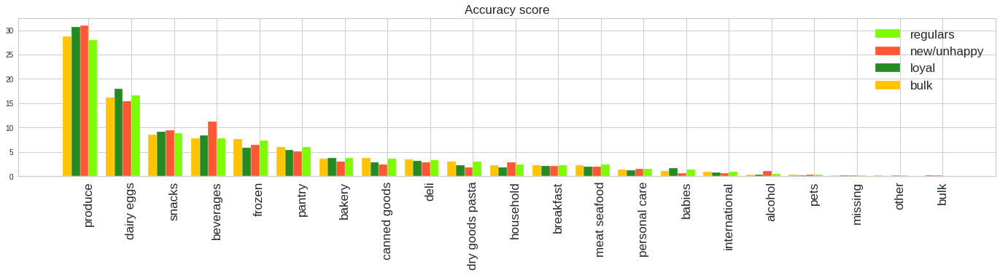

In [ ]:
plt.rcParams["figure.figsize"] = (24, 4)
plt.rcParams["xtick.labelsize"] = 12

width = 0.2
dept_percent_clust = []

#Getting department %age shopped by each cluster
for grp in range(0,4):
  dept_percent_clust.append([t[0] for t in list(dict(dept[grp]).values())])


X = np.arange(len(dept_percent_clust[0]))
ax = plt.subplot(111)

ax.bar(X, dept_percent_clust[0], width=width, color='#7CFC00', align='edge')
ax.bar(X-width, dept_percent_clust[1], width=width, color='#FF5733', align='edge')
ax.bar(X-2*width, dept_percent_clust[2], width=width, color='#228B22', align='edge')
ax.bar(X-3*width, dept_percent_clust[3], width=width, color='#FFC300', align='edge')

ax.legend(('regulars','new/unhappy','loyal','bulk'),fontsize=17)

plt.xticks(X, all_dept_sorted,rotation=90, fontsize=17)
plt.title("Accuracy score", fontsize=17)
plt.show()

**Observations/conclusions**


***Cluster 0 (REGULARS)***


They buy alot of
*  Frozen
*  Pantry
* Bakery
* Meat seafood


And less
* Beverages



***Cluster 1 (NEW/UNHAPPY)***


They buy alot of
*  snacks and beverages
*  Alcohol
*  Household items

And less
* Bakery
* Dairy eggs
* Dry goods pasta
* Baby products

These customers shop rarely with instacart and this is evident as they normally buy alot of snacks and beverages, Alcohol, Household items which are generally one time buys or can easily be  available locally(offline) or through other apps. 

The type of products they buy need to be unique or special as in this way they will be motivated to shop only from instacart due to the variety avaialable.





***Cluster 2 (LOYAL)***

They buy alot of
*  Dairy Eggs
*  Produce
* Baby products

And less
* Frozen
* Canned goods
* Dry goods pasta
* House hold
* Personal care

These customers since they order very frequently normally buy perishables.



***Cluster 3 (BULK)***

They buy alot of
*  Frozen
*  Pantry
* Canned goods


And less
* Snacks
* Beverages
* Dairy Eggs

These customers seem to buy non-perishables since they generally buy in bulk and hoard.



**Which group reorders the most?**

In [ ]:
uxp_reorder = merg_df[["cluster_4", "reordered","user_id","product_id"]]
num_times_product_ever_purchased = uxp_reorder.groupby(["product_id"]).count()['reordered'].reset_index(drop=False)
num_times_product_ever_purchased.rename(columns={'reordered': 'num_times_ever_ordered'}, inplace=True)

In [ ]:
num_times_product_ever_purchased = num_times_product_ever_purchased[num_times_product_ever_purchased['num_times_ever_ordered']<50]

num_times_product_ever_purchased = pd.merge(num_times_product_ever_purchased, products_df, on='product_id',how='left')[['product_id',"product_name",'num_times_ever_ordered']]
num_times_product_ever_purchased.head()

,product_id,product_name,num_times_ever_ordered
0,5,Green Chile Anytime Sauce,15
1,6,Dry Nose Oil,8
2,7,Pure Coconut Water With Orange,30
3,13,Saline Nasal Mist,9
4,14,Fresh Scent Dishwasher Cleaner,17


In [ ]:
uxp_reorder.head()

,cluster_4,reordered,user_id,product_id
0,1,0,1,41787
1,1,1,1,25133
2,1,0,1,17122
3,1,1,1,13176
4,1,1,1,12427


In [ ]:
uxp_reorder_filtered = uxp_reorder[~(uxp_reorder['product_id'].isin(num_times_product_ever_purchased['product_id'].values))]
uxp_reorder_filtered.head()

,cluster_4,reordered,user_id,product_id
0,1,0,1,41787
1,1,1,1,25133
2,1,0,1,17122
3,1,1,1,13176
4,1,1,1,12427


In [ ]:
uxp_reorder_filtered = uxp_reorder_filtered.groupby(["cluster_4"]).agg({'reordered': ['mean']})['reordered'].reset_index(drop=False)
uxp_reorder_filtered['cluster_names'] = cluster_names
uxp_reorder_filtered

,cluster_4,mean,cluster_names
0,0,0.616306,regulars
1,1,0.453859,new/unhappy
2,2,0.749208,loyal
3,3,0.450890,bulk


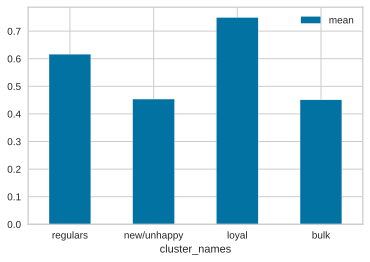

In [ ]:
uxp_reorder_filtered.plot.bar(x ="cluster_names", y='mean', rot=0)

**Observation/conclusion**

1. Loyal customers on avg of all the products they have bought they reorder 75% of them frequently.
2. Regular customers on avg of all the products they have bought they reorder 62% of them.
2. New and bulk orderers reorder at slower rates.
3. Thus Cluster id of user could be useful to predict if he is likely to reorder a product or not. 

**How long have each cluster been with instacart**

In [ ]:
days_per_user = merg_df.groupby(["cluster_4","user_id"]).agg({'days_since_prior_order': ['count']})['days_since_prior_order'].reset_index(drop=False)
days_per_user.head()

,cluster_4,user_id,count
0,0,14,205
1,0,17,291
2,0,19,172
3,0,21,200
4,0,28,179


On avergae regulars have been with instacart for roughly 274.0 days
On avergae new/unhappy have been with instacart for roughly 27.0 days
On avergae loyal have been with instacart for roughly 582.0 days
On avergae bulk have been with instacart for roughly 89.0 days


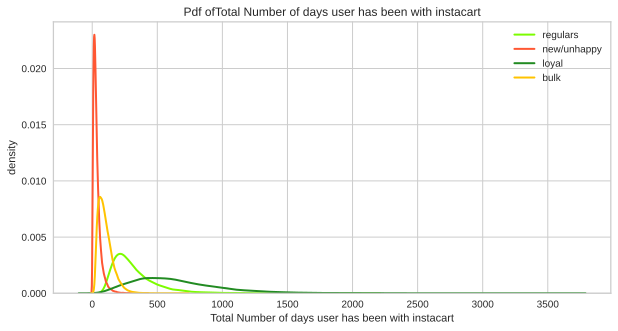

In [ ]:
plt.rcParams["figure.figsize"] = (10, 5)
plt.rcParams["xtick.labelsize"] = 10

fig, axes = plt.subplots()

for grp in range(0,4):
    x = days_per_user[days_per_user['cluster_4']==grp]['count'].values
    print(f"On avergae {cluster_names[grp]} have been with instacart for roughly {np.median(x)} days")
    ax = sns.distplot(x= x, kde=True, bins = 7, ax = axes, hist = False,label=grp, color = colors[grp], kde_kws=dict(linewidth=2))


ax.legend(cluster_names,fontsize=10)
ax.set(xlabel='Total Number of days user has been with instacart', ylabel='density',title='Pdf ofTotal Number of days user has been with instacart')

plt.show()

**Observation/Conclusions**
1. It is clear that the loyal customers have been using instacart for the longest time with median no. of days as 582
2. New/Unhappy customers have roughly been with instacart for 1 month.
3. Regular customers have also been using instacart for a while with median no. of days as 274.
4. Bulk orderers have been using it for rouhly 3 months.